In [1]:
import kagglehub

# Download latest version
path = kagglehub.dataset_download("parisrohan/credit-score-classification")

print("Path to dataset files:", path)

Path to dataset files: C:\Users\ziyad\.cache\kagglehub\datasets\parisrohan\credit-score-classification\versions\1


In [2]:
import pandas as pd

In [ ]:
df = pd.read_csv("C:/Users/ziyad/.cache/kagglehub/datasets/parisrohan/credit-score-classification/versions/1/train.csv")
df.head()

C:\Users\ziyad\AppData\Local\Temp\ipykernel_12660\3338728209.py:1: DtypeWarning: Columns (26) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv("C:/Users/ziyad/.cache/kagglehub/datasets/parisrohan/credit-score-classification/versions/1/train.csv")


,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,...,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score
0,0x1602,CUS_0xd40,January,Aaron Maashoh,23,821-00-0265,Scientist,19114.12,1824.843333,3,...,_,809.98,26.822620,22 Years and 1 Months,No,49.574949,80.41529543900253,High_spent_Small_value_payments,312.49408867943663,Good
1,0x1603,CUS_0xd40,February,Aaron Maashoh,23,821-00-0265,Scientist,19114.12,NaN,3,...,Good,809.98,31.944960,NaN,No,49.574949,118.28022162236736,Low_spent_Large_value_payments,284.62916249607184,Good
2,0x1604,CUS_0xd40,March,Aaron Maashoh,-500,821-00-0265,Scientist,19114.12,NaN,3,...,Good,809.98,28.609352,22 Years and 3 Months,No,49.574949,81.699521264648,Low_spent_Medium_value_payments,331.2098628537912,Good
3,0x1605,CUS_0xd40,April,Aaron Maashoh,23,821-00-0265,Scientist,19114.12,NaN,3,...,Good,809.98,31.377862,22 Years and 4 Months,No,49.574949,199.4580743910713,Low_spent_Small_value_payments,223.45130972736786,Good
4,0x1606,CUS_0xd40,May,Aaron Maashoh,23,821-00-0265,Scientist,19114.12,1824.843333,3,...,Good,809.98,24.797347,22 Years and 5 Months,No,49.574949,41.420153086217326,High_spent_Medium_value_payments,341.48923103222177,Good


In [4]:
df.isnull().sum()

ID                              0
Customer_ID                     0
Month                           0
Name                         9985
Age                             0
SSN                             0
Occupation                      0
Annual_Income                   0
Monthly_Inhand_Salary       15002
Num_Bank_Accounts               0
Num_Credit_Card                 0
Interest_Rate                   0
Num_of_Loan                     0
Type_of_Loan                11408
Delay_from_due_date             0
Num_of_Delayed_Payment       7002
Changed_Credit_Limit            0
Num_Credit_Inquiries         1965
Credit_Mix                      0
Outstanding_Debt                0
Credit_Utilization_Ratio        0
Credit_History_Age           9030
Payment_of_Min_Amount           0
Total_EMI_per_month             0
Amount_invested_monthly      4479
Payment_Behaviour               0
Monthly_Balance              1200
Credit_Score                    0
dtype: int64

# Pembersihan Data Numerik

Sebelum kita membersihkan data tersebut, kita perlu memeriksa tipe data dari setiap feature tersebut. Berikut merupakan contoh kode untuk melakukannya.

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 28 columns):
 #   Column                    Non-Null Count   Dtype  
---  ------                    --------------   -----  
 0   ID                        100000 non-null  object 
 1   Customer_ID               100000 non-null  object 
 2   Month                     100000 non-null  object 
 3   Name                      90015 non-null   object 
 4   Age                       100000 non-null  object 
 5   SSN                       100000 non-null  object 
 6   Occupation                100000 non-null  object 
 7   Annual_Income             100000 non-null  object 
 8   Monthly_Inhand_Salary     84998 non-null   float64
 9   Num_Bank_Accounts         100000 non-null  int64  
 10  Num_Credit_Card           100000 non-null  int64  
 11  Interest_Rate             100000 non-null  int64  
 12  Num_of_Loan               100000 non-null  object 
 13  Type_of_Loan              88592 non-null   ob

Seperti yang bisa Anda lihat pada gambar di atas, terdapat beberapa feature yang memiliki tipe data yang tidak sesuai dengan deskripsinya. Hal ini berarti terdapat beberapa feature yang memiliki nilai yang salah (invalid value). Untuk mengecek hal tersebut, kita bisa menggunakan method describe() yang disediakan oleh pandas. Berikut merupakan contoh penggunaannya.

In [6]:
df. describe(include="all")

,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,...,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score
count,100000,100000,100000,90015,100000,100000,100000,100000,84998.000000,100000.000000,...,100000,100000,100000.000000,90970,100000,100000.000000,95521,100000,98800,100000
unique,100000,12500,8,10139,1788,12501,16,18940,NaN,NaN,...,4,13178,NaN,404,3,NaN,91049,7,98792,3
top,0x1602,CUS_0xd40,January,Langep,38,#F%$D@*&8,_______,36585.12,NaN,NaN,...,Standard,1360.45,NaN,15 Years and 11 Months,Yes,NaN,__10000__,Low_spent_Small_value_payments,__-333333333333333333333333333__,Standard
freq,1,8,12500,44,2833,5572,7062,16,NaN,NaN,...,36479,24,NaN,446,52326,NaN,4305,25513,9,53174
mean,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4194.170850,17.091280,...,NaN,NaN,32.285173,NaN,NaN,1403.118217,NaN,NaN,NaN,NaN
std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3183.686167,117.404834,...,NaN,NaN,5.116875,NaN,NaN,8306.041270,NaN,NaN,NaN,NaN
min,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,303.645417,-1.000000,...,NaN,NaN,20.000000,NaN,NaN,0.000000,NaN,NaN,NaN,NaN
25%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1625.568229,3.000000,...,NaN,NaN,28.052567,NaN,NaN,30.306660,NaN,NaN,NaN,NaN
50%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3093.745000,6.000000,...,NaN,NaN,32.305784,NaN,NaN,69.249473,NaN,NaN,NaN,NaN
75%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5957.448333,7.000000,...,NaN,NaN,36.496663,NaN,NaN,161.224249,NaN,NaN,NaN,NaN


Jika Anda perhatikan, terdapat beberapa nilai yang bermasalah seperti “__10000__”, “__-333333333333333333333333333__”, dll. Nilai inilah yang perlu kita bersihkan untuk mengubah tipe data dari feature tersebut. Untuk melakukan hal ini, kita membutuhkan helper function berikut.

In [7]:
def return_null(val):
    if isinstance(val, str) and "__" in val:
        return np.NaN
    elif isinstance(val, str) and "_" in val:
        return np.NaN
    else:
        return val

Helper function di atas akan mengubah semua nilai yang mengandung “_” atau “__” menjadi sebuah np.NaN yang merupakan missing value. Berikut merupakan contoh kode untuk menggunakan helper function tersebut.

In [8]:
import numpy as np

new_df = df.copy()
invalid_numerical_columns = [
    'Age',
    'Annual_Income',
    'Monthly_Inhand_Salary',
    'Num_of_Loan',
    'Num_of_Delayed_Payment',
    'Changed_Credit_Limit',
    'Outstanding_Debt',
    'Amount_invested_monthly',
    'Monthly_Balance'
]
 
for col in invalid_numerical_columns:
    new_df[col] = new_df[col].apply(return_null)
    new_df[col] = new_df[col].astype('float')
 
new_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 28 columns):
 #   Column                    Non-Null Count   Dtype  
---  ------                    --------------   -----  
 0   ID                        100000 non-null  object 
 1   Customer_ID               100000 non-null  object 
 2   Month                     100000 non-null  object 
 3   Name                      90015 non-null   object 
 4   Age                       95061 non-null   float64
 5   SSN                       100000 non-null  object 
 6   Occupation                100000 non-null  object 
 7   Annual_Income             93020 non-null   float64
 8   Monthly_Inhand_Salary     84998 non-null   float64
 9   Num_Bank_Accounts         100000 non-null  int64  
 10  Num_Credit_Card           100000 non-null  int64  
 11  Interest_Rate             100000 non-null  int64  
 12  Num_of_Loan               95215 non-null   float64
 13  Type_of_Loan              88592 non-null   ob

Nah, bisa Anda lihat sebagian besar feature telah memiliki tipe data yang sesuai, kecuali feature Credit_History_Age. Untuk memperbaikinya, kita memerlukan helper function lain seperti berikut.

In [9]:
import re
 
def cal_history_age(val):
    try:
        year, month = 0, 0
        if re.search('year', val, re.IGNORECASE):
            year = int(re.findall('\d+', val)[0])
        if re.search('month', val, re.IGNORECASE):
            month = int(re.findall('\d+', val)[1])
        return year*12+month
    except:
        return np.NaN

Sederhananya, helper function tersebut akan mengambil komponen tahun dan bulan yang terdapat dalam data Credit_History_Age. Proses ini dilakukan dengan menggunakan teknik Regular expression (regex) untuk mencari pola karakter yang tepat (Python Regular Expressions). Helper function ini akan mengembalikan total bulan dari riwayat kredit pelanggan dan nilai np.NaN jika gagal. Berikut merupakan contoh penggunaan dari helper function tersebut.

In [10]:
new_df['Credit_History_Age'] = new_df['Credit_History_Age'].apply(cal_history_age)
new_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 28 columns):
 #   Column                    Non-Null Count   Dtype  
---  ------                    --------------   -----  
 0   ID                        100000 non-null  object 
 1   Customer_ID               100000 non-null  object 
 2   Month                     100000 non-null  object 
 3   Name                      90015 non-null   object 
 4   Age                       95061 non-null   float64
 5   SSN                       100000 non-null  object 
 6   Occupation                100000 non-null  object 
 7   Annual_Income             93020 non-null   float64
 8   Monthly_Inhand_Salary     84998 non-null   float64
 9   Num_Bank_Accounts         100000 non-null  int64  
 10  Num_Credit_Card           100000 non-null  int64  
 11  Interest_Rate             100000 non-null  int64  
 12  Num_of_Loan               95215 non-null   float64
 13  Type_of_Loan              88592 non-null   ob

Yey, sekarang kita telah berhasil memperbaiki tipe data dari seluruh feature numerik. Sekarang kita coba memilih feature numerik mana yang akan digunakan. Proses ini biasanya dilakukan berdasarkan background knowledge dan atau hasil EDA (kita akan melakukannya pada materi berikutnya).

Berdasarkan background knowledge, kita mengetahui bahwa feature Annual_Income dan Monthly_Inhand_Salary merepresentasikan hal yang sama yaitu pendapatan yang diperoleh setiap pelanggan. Oleh karena itu, kita hanya akan memilih salah satu dari keduanya. Berikut merupakan contoh kode untuk menghilangkan (drop) feature Annual_Income serta beberapa feature lain yang tidak dibutuhkan seperti Name dan SSN.

In [11]:
new_df.drop(["ID", "Name", "SSN", "Annual_Income"], axis=1, inplace=True)

Setelah menghilangkan beberapa feature tersebut, kini saatnya kita melanjutkan proses pembersihan data. Pada proyek ini, kita akan mulai dengan membersihkan feature numerik terlebih dahulu. Tahap pertama, kita akan memeriksa rangkuman parameter statistik dari kolom tersebut menggunakan kode di bawah ini.

In [12]:
numerical_columns = [
    'Age',
    'Monthly_Inhand_Salary',
    'Num_Bank_Accounts',
    'Num_Credit_Card',
    'Interest_Rate',
    'Num_of_Loan',
    'Delay_from_due_date',
    'Num_of_Delayed_Payment',
    'Changed_Credit_Limit',
    'Num_Credit_Inquiries',
    'Outstanding_Debt',
    'Credit_Utilization_Ratio',
    'Total_EMI_per_month',
    'Amount_invested_monthly',
    'Monthly_Balance',
    'Credit_History_Age'
]

new_df[numerical_columns].describe()

,Age,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,Num_Credit_Inquiries,Outstanding_Debt,Credit_Utilization_Ratio,Total_EMI_per_month,Amount_invested_monthly,Monthly_Balance,Credit_History_Age
count,95061.000000,84998.000000,100000.000000,100000.00000,100000.000000,95215.000000,100000.000000,90254.000000,97909.000000,98035.000000,98991.000000,100000.000000,100000.000000,91216.000000,98791.000000,90970.000000
mean,110.934505,4194.170850,17.091280,22.47443,72.466040,2.780339,21.068780,31.033051,10.389025,27.754251,1426.503700,32.285173,1403.118217,195.539456,402.551258,221.195405
std,689.407864,3183.686167,117.404834,129.05741,466.422621,62.500940,14.860104,226.955758,6.789496,193.177339,1155.045753,5.116875,8306.041270,199.564527,213.925499,99.741364
min,-500.000000,303.645417,-1.000000,0.00000,1.000000,-100.000000,-5.000000,-3.000000,-6.490000,0.000000,0.230000,20.000000,0.000000,0.000000,0.007760,1.000000
25%,24.000000,1625.568229,3.000000,4.00000,8.000000,1.000000,10.000000,9.000000,5.320000,3.000000,566.080000,28.052567,30.306660,72.236692,270.106630,144.000000
50%,33.000000,3093.745000,6.000000,5.00000,13.000000,3.000000,18.000000,14.000000,9.400000,6.000000,1166.370000,32.305784,69.249473,128.954538,336.731225,219.000000
75%,42.000000,5957.448333,7.000000,7.00000,20.000000,5.000000,28.000000,18.000000,14.870000,9.000000,1948.200000,36.496663,161.224249,236.815814,470.262938,302.000000
max,8698.000000,15204.633333,1798.000000,1499.00000,5797.000000,1496.000000,67.000000,4397.000000,36.970000,2597.000000,4998.070000,50.000000,82331.000000,1977.326102,1602.040519,404.000000


Nah, berdasarkan hasil tersebut terlihat beberapa nilai yang tidak biasa seperti umur -500 tahun, jumlah akun bank sebanyak 1798, dll. Nilai tersebut perlu divalidasi terlebih dahulu. Berikut merupakan contoh kode untuk memvalidasi nilai tersebut.

In [13]:
def check_invalid_values(df, invalid_value, column):
    df = df.copy()
    customer_id = df[(df[column] == invalid_value)].groupby(by="Customer_ID", as_index=False)["Num_Bank_Accounts"].mean()
    print(df[df.Customer_ID.isin(customer_id.Customer_ID)])

check_invalid_values(new_df, -500, "Age")

      Customer_ID     Month    Age Occupation  Monthly_Inhand_Salary  \
0       CUS_0xd40   January   23.0  Scientist            1824.843333   
1       CUS_0xd40  February   23.0  Scientist                    NaN   
2       CUS_0xd40     March -500.0  Scientist                    NaN   
3       CUS_0xd40     April   23.0  Scientist                    NaN   
4       CUS_0xd40       May   23.0  Scientist            1824.843333   
...           ...       ...    ...        ...                    ...   
99963  CUS_0x372c     April -500.0     Lawyer                    NaN   
99964  CUS_0x372c       May   18.0     Lawyer            3468.315833   
99965  CUS_0x372c      June   19.0     Lawyer            3468.315833   
99966  CUS_0x372c      July   19.0     Lawyer            3468.315833   
99967  CUS_0x372c    August   19.0     Lawyer            3468.315833   

       Num_Bank_Accounts  Num_Credit_Card  Interest_Rate  Num_of_Loan  \
0                      3                4              3      

Kode tersebut akan menghasilkan output seperti pada gambar di bawah ini yang menunjukkan data pelanggan dengan umur -500 tahun. Anda dapat menyesuaikan kode di atas untuk melihat data yang mengandung nilai yang tidak biasa pada feature yang lain.



Setelah melakukan validasi terhadap beberapa nilai yang tidak biasa tersebut, Anda mengetahui bahwa nilai tersebut merupakan nilai yang tidak valid. Jika melakukan validasi secara teliti, Anda akan menemukan beberapa invalid value pada beberapa feature seperti berikut.

- Pada kolom Age, semua nilai yang lebih kecil dari 0 atau lebih besar dari 90 merupakan invalid value.
- Pada kolom Num_Bank_Accounts, semua nilai yang lebih kecil dari 0 atau lebih besar dari 15 merupakan invalid value.
- Pada kolom Num_Credit_Card, semua nilai yang lebih kecil dari 0 atau lebih besar dari 15 merupakan invalid value.
- Pada kolom Interest_Rate, semua nilai yang lebih besar dari 50 merupakan invalid value.
- Pada kolom Num_of_Loan, semua nilai yang lebih kecil dari 0 atau lebih besar dari 10 merupakan invalid value.
- Pada kolom Delay_from_due_date, semua nilai yang lebih kecil dari 0 merupakan invalid value.
- Pada kolom Num_of_Delayed_Paymen, semua nilai yang lebih kecil dari 0 atau lebih besar dari 30 merupakan invalid value.
- Pada kolom Changed_Credit_Limit, semua nilai yang lebih kecil dari 0 merupakan invalid value.
- Pada kolom Num_Credit_Inquiries, semua nilai yang lebih besar dari 25 merupakan invalid value.
- Pada kolom Total_EMI_per_month, semua nilai yang lebih besar dari 1400 merupakan invalid value.

In [14]:
new_df["Age"] = new_df.Age.apply(lambda x: np.NaN if x<0 or x>90 else x)
new_df["Num_Bank_Accounts"] = new_df.Num_Bank_Accounts.apply(lambda x: np.NaN if x<0 or x>15 else x)
new_df["Num_Credit_Card"] = new_df.Num_Credit_Card.apply(lambda x: np.NaN if x<0 or x>15 else x)
new_df["Interest_Rate"] = new_df.Interest_Rate.apply(lambda x: np.NaN if x>50 else x)
new_df["Num_of_Loan"] = new_df.Num_of_Loan.apply(lambda x: np.NaN if x<0 or x>10 else x)
new_df["Delay_from_due_date"] = new_df.Delay_from_due_date.apply(lambda x: 0.0 if x<0 else x)
new_df["Num_of_Delayed_Payment"] = new_df.Num_of_Delayed_Payment.apply(lambda x: np.NaN if x<0 or x>30 else x)
new_df["Changed_Credit_Limit"] = new_df.Changed_Credit_Limit.apply(lambda x: 0.0 if x<0 else x)
new_df["Num_Credit_Inquiries"] = new_df.Num_Credit_Inquiries.apply(lambda x: np.NaN if x>25 else x)
new_df["Total_EMI_per_month"] = new_df.Total_EMI_per_month.apply(lambda x: np.NaN if x>1400 else x)

new_df[numerical_columns].describe(include="all")

,Age,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,Num_Credit_Inquiries,Outstanding_Debt,Credit_Utilization_Ratio,Total_EMI_per_month,Amount_invested_monthly,Monthly_Balance,Credit_History_Age
count,92365.000000,84998.000000,98664.000000,97732.000000,97966.000000,90892.000000,100000.000000,88915.000000,97909.000000,96385.000000,98991.000000,100000.000000,96781.000000,91216.000000,98791.000000,90970.000000
mean,33.314145,4194.170850,5.368980,5.533612,14.531603,3.534172,21.081910,13.424529,10.427352,5.781117,1426.503700,32.285173,106.036989,195.539456,402.551258,221.195405
std,10.770143,3183.686167,2.592451,2.068336,8.739748,2.447488,14.840204,6.207212,6.720510,3.860712,1155.045753,5.116875,122.739064,199.564527,213.925499,99.741364
min,14.000000,303.645417,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.230000,20.000000,0.000000,0.000000,0.007760,1.000000
25%,24.000000,1625.568229,3.000000,4.000000,7.000000,2.000000,10.000000,9.000000,5.320000,3.000000,566.080000,28.052567,29.270265,72.236692,270.106630,144.000000
50%,33.000000,3093.745000,5.000000,5.000000,13.000000,3.000000,18.000000,14.000000,9.400000,5.000000,1166.370000,32.305784,66.413778,128.954538,336.731225,219.000000
75%,42.000000,5957.448333,7.000000,7.000000,20.000000,5.000000,28.000000,18.000000,14.870000,8.000000,1948.200000,36.496663,146.701253,236.815814,470.262938,302.000000
max,56.000000,15204.633333,11.000000,15.000000,34.000000,9.000000,67.000000,28.000000,36.970000,17.000000,4998.070000,50.000000,1396.000000,1977.326102,1602.040519,404.000000


Bagaimana menurut Anda? Sekarang nilainya lebih masuk akal bukan? Sekarang kita coba mengecek missing value yang terdapat dalam feature numerik menggunakan kode di bawah ini.

In [15]:
numerical_columns = [
    'Age',
    'Monthly_Inhand_Salary',
    'Num_Bank_Accounts',
    'Num_Credit_Card',
    'Interest_Rate',
    'Num_of_Loan',
    'Delay_from_due_date',
    'Num_of_Delayed_Payment',
    'Changed_Credit_Limit',
    'Num_Credit_Inquiries',
    'Outstanding_Debt',
    'Credit_Utilization_Ratio',
    'Total_EMI_per_month',
    'Amount_invested_monthly',
    'Monthly_Balance',
    'Credit_History_Age'
]

new_df[numerical_columns].isnull().sum()

Age                          7635
Monthly_Inhand_Salary       15002
Num_Bank_Accounts            1336
Num_Credit_Card              2268
Interest_Rate                2034
Num_of_Loan                  9108
Delay_from_due_date             0
Num_of_Delayed_Payment      11085
Changed_Credit_Limit         2091
Num_Credit_Inquiries         3615
Outstanding_Debt             1009
Credit_Utilization_Ratio        0
Total_EMI_per_month          3219
Amount_invested_monthly      8784
Monthly_Balance              1209
Credit_History_Age           9030
dtype: int64

Sesuai ekspektasi, kita memiliki cukup banyak missing value. Untuk membersihkan missing value tersebut, kita perlu membuat strategi berdasarkan pengamatan terhadap data dan background knowledge.

Sesuai ekspektasi, kita memiliki cukup banyak missing value. Untuk membersihkan missing value tersebut, kita perlu membuat strategi berdasarkan pengamatan terhadap data dan background knowledge.

Pada proyek ini, kita memiliki data setiap pelanggan selama bulan Januari sampai Agustus. Nah, kita bisa mengambil nilai median dari data bulan Januari sampai Agustus untuk mengganti missing value yang terdapat dalam dataset. Untuk melakukan hal ini, kita perlu mengelompokkan data berdasarkan Customer_ID dan mengambil nilai median untuk suatu kolom tertentu. Nilai inilah yang akan digunakan untuk menggantikan missing value pada kolom tersebut. Berikut merupakan contoh implementasi kode untuk melakukannya.

In [16]:
def fill_numerical_missing_value(column, how, df):
    df = df.copy()

    missing_customer_id = df[df[column].isna()].Customer_ID
    new = df[df.Customer_ID.isin(missing_customer_id)].groupby(by="Customer_ID", as_index=False).agg({
        column: how
    })

    for index, row in df[df[column].isna()].iterrows():
        df[column].iloc[index] = new[new.Customer_ID == str(row["Customer_ID"])][column]

    return df[column]

missing_numerical_columns = [
    'Age',
    'Monthly_Inhand_Salary',
    'Num_Bank_Accounts',
    'Num_Credit_Card',
    'Interest_Rate',
    'Num_of_Loan',
    'Num_of_Delayed_Payment',
    'Changed_Credit_Limit',
    'Num_Credit_Inquiries',
    'Outstanding_Debt',
    'Total_EMI_per_month',
    'Amount_invested_monthly'
]

for col in missing_numerical_columns:
    new_df[col] = fill_numerical_missing_value(
        column=col,
        how="median",
        df=new_df
    )

C:\Users\ziyad\AppData\Local\Temp\ipykernel_12660\3137575157.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[column].iloc[index] = new[new.Customer_ID == str(row["Customer_ID"])][column]
C:\Users\ziyad\AppData\Local\Temp\ipykernel_12660\3137575157.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[column].iloc[index] = new[new.Customer_ID == str(row["Customer_ID"])][column]
C:\Users\ziyad\AppData\Local\Temp\ipykernel_12660\3137575157.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

Kode di atas akan membersihkan missing value yang terdapat dalam semua feature numerik kecuali Monthly_Balance dan Credit_History_Age. Pada kedua feature tersebut, kita akan menggunakan nilai sebelumnya atau sesudahnya untuk mengganti missing value. Proses ini dilakukan menggunakan method ffill() (mengisi missing value dengan nilai sesudahnya) dan bfill() (mengisi missing value dengan nilai sebelumnya) seperti pada contoh kode berikut.

In [17]:
new_df['Monthly_Balance'] = new_df.groupby('Customer_ID')['Monthly_Balance'].transform(lambda v: v.ffill())
new_df['Monthly_Balance'] = new_df.groupby('Customer_ID')['Monthly_Balance'].transform(lambda v: v.bfill())
new_df['Monthly_Balance'] = new_df['Monthly_Balance'].astype('float')

new_df['Credit_History_Age'] = new_df.groupby('Customer_ID')['Credit_History_Age'].transform(lambda v: v.ffill())
new_df['Credit_History_Age'] = new_df.groupby('Customer_ID')['Credit_History_Age'].transform(lambda v: v.bfill())
new_df['Credit_History_Age'] = new_df['Credit_History_Age'].astype('float')

# Pembersihan Data Kategorikal

Oke, sekarang kita akan membersihkan feature kategorikal yang terdapat dalam dataset. Untuk melakukannya, pertama kita perlu mengecek nilai dari setiap feature kategorikal tersebut. Berikut merupakan contoh kode untuk melakukannya.

In [18]:
categorical_columns = [
    'Month',
    'Occupation',
    'Type_of_Loan',
    'Credit_Mix',
    'Payment_of_Min_Amount',
    'Payment_Behaviour',
    'Credit_Score'
]

for col in categorical_columns:
    print(new_df[col].value_counts())

Month
January     12500
February    12500
March       12500
April       12500
May         12500
June        12500
July        12500
August      12500
Name: count, dtype: int64
Occupation
_______          7062
Lawyer           6575
Architect        6355
Engineer         6350
Scientist        6299
Mechanic         6291
Accountant       6271
Developer        6235
Media_Manager    6232
Teacher          6215
Entrepreneur     6174
Doctor           6087
Journalist       6085
Manager          5973
Musician         5911
Writer           5885
Name: count, dtype: int64
Type_of_Loan
Not Specified                                                                                                                         1408
Credit-Builder Loan                                                                                                                   1280
Personal Loan                                                                                                                         1272
Debt 

Jika melihat hasil tersebut secara mendetail, Anda akan menemukan beberapa invalid value seperti pada feature Occupation terdapat nilai “_______” serta pada feature Payment_Behaviour terdapat nilai “!@9#%8”. Selain itu, pada feature Type_of_Loan terdapat data yang memiliki lebih dari satu kategori contohnya, seperti “Not Specified, Mortgage Loan, Auto Loan, dan Payday Loan“.

Untuk membersihkan beberapa masalah tersebut, Anda dapat menjalankan kode berikut.

In [19]:
new_df['Occupation'] = new_df['Occupation'].apply(lambda x: np.NaN if x == "_______" else x)
new_df['Credit_Mix'] = new_df['Credit_Mix'].str.replace('_','Unknown')
new_df['Payment_Behaviour'] = new_df['Payment_Behaviour'].str.replace('!@9#%8','Unknown')

new_df['Type_of_Loan'] = new_df[~(new_df.Type_of_Loan.isna())]['Type_of_Loan'].apply(lambda x: str(x).split(',')[0])

Pada kode di atas, Anda mengganti nilai “_______” dalam feature Occupatio menjadi missing value. Kemudian menggubah invalid value pada feature Credit_Mix dan Payment_Behaviour menjadi nilai “Unknown”. Selain itu, pada feature Type_of_Loan, kita hanya akan mengambil kategori pertama untuk data yang memiliki lebih dari satu kategori.

In [20]:
categorical_columns = [
    'Month',
    'Occupation',
    'Type_of_Loan',
    'Credit_Mix',
    'Payment_of_Min_Amount',
    'Payment_Behaviour',
    'Credit_Score'
]

for col in categorical_columns:
    print(new_df[col].value_counts())

Month
January     12500
February    12500
March       12500
April       12500
May         12500
June        12500
July        12500
August      12500
Name: count, dtype: int64
Occupation
Lawyer           6575
Architect        6355
Engineer         6350
Scientist        6299
Mechanic         6291
Accountant       6271
Developer        6235
Media_Manager    6232
Teacher          6215
Entrepreneur     6174
Doctor           6087
Journalist       6085
Manager          5973
Musician         5911
Writer           5885
Name: count, dtype: int64
Type_of_Loan
Credit-Builder Loan        10416
Payday Loan                10248
Personal Loan              10200
Not Specified               9848
Student Loan                9672
Debt Consolidation Loan     9648
Mortgage Loan               9632
Auto Loan                   9568
Home Equity Loan            9360
Name: count, dtype: int64
Credit_Mix
Standard    36479
Good        24337
Unknown     20195
Bad         18989
Name: count, dtype: int64
Payment_of_M

In [21]:
new_df[categorical_columns].isna().sum()

Month                        0
Occupation                7062
Type_of_Loan             11408
Credit_Mix                   0
Payment_of_Min_Amount        0
Payment_Behaviour            0
Credit_Score                 0
dtype: int64

Berdasarkan hasil tersebut, terdapat missing value pada feature Occupation dan Type_of_Loan. Untuk membersihkan missing value dari kolom feature Occupation, kita akan menggunakan nilai sebelumnya atau sesudahnya. Missing value pada feature Type_of_Loan akan diubah menjadi “Not Specified”. Berikut merupakan kode untuk melakukannya.

In [22]:
new_df['Occupation'] = new_df.groupby('Customer_ID')['Occupation'].transform(lambda v: v.ffill())
new_df['Occupation'] = new_df.groupby('Customer_ID')['Occupation'].transform(lambda v: v.bfill())

new_df["Type_of_Loan"].fillna(value="Not Specified", inplace=True)

In [23]:
new_df[categorical_columns].isna().sum()

Month                    0
Occupation               0
Type_of_Loan             0
Credit_Mix               0
Payment_of_Min_Amount    0
Payment_Behaviour        0
Credit_Score             0
dtype: int64

# Exploratory Data Analysis

Setelah selesai membersihkan data, kini saatnya kita masuk ke tahap berikutnya yaitu Exploratory Data Analysis (EDA). Tentunya Anda masih ingat bukan tujuan dari tahap EDA ini? Yap, betul sekali, pada tahap ini, kita akan coba mencari pola dan insight menarik guna memperoleh gambaran terkait data. Hal ini akan sangat membantu kita dalam proses pengembangan model nantinya.

In [24]:
cleaned_df = new_df.copy()
cleaned_df.describe(include="all")

,Customer_ID,Month,Age,Occupation,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Type_of_Loan,...,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score
count,100000,100000,100000.00000,100000,100000.000000,100000.000000,100000.000000,100000.00000,100000.000000,100000,...,100000,100000.000000,100000.000000,100000.000000,100000,100000.000000,100000.000000,100000,100000.000000,100000
unique,12500,8,NaN,15,NaN,NaN,NaN,NaN,NaN,9,...,4,NaN,NaN,NaN,3,NaN,NaN,7,NaN,3
top,CUS_0xd40,January,NaN,Lawyer,NaN,NaN,NaN,NaN,NaN,Not Specified,...,Standard,NaN,NaN,NaN,Yes,NaN,NaN,Low_spent_Small_value_payments,NaN,Standard
freq,8,12500,NaN,7096,NaN,NaN,NaN,NaN,NaN,21256,...,36479,NaN,NaN,NaN,52326,NaN,NaN,25513,NaN,53174
mean,NaN,NaN,33.31111,NaN,4198.490149,5.368840,5.533910,14.53208,3.532880,NaN,...,NaN,1426.220376,32.285173,221.136220,NaN,106.019121,193.686347,NaN,403.067273,NaN
std,NaN,NaN,10.76504,NaN,3187.491752,2.593273,2.067712,8.74133,2.446356,NaN,...,NaN,1155.129026,5.116875,99.680454,NaN,122.790313,194.785222,NaN,214.796261,NaN
min,NaN,NaN,14.00000,NaN,303.645417,0.000000,0.000000,1.00000,0.000000,NaN,...,NaN,0.230000,20.000000,1.000000,NaN,0.000000,0.000000,NaN,0.007760,NaN
25%,NaN,NaN,24.00000,NaN,1626.761667,3.000000,4.000000,7.00000,2.000000,NaN,...,NaN,566.072500,28.052567,144.000000,NaN,29.179343,73.730625,NaN,270.034729,NaN
50%,NaN,NaN,33.00000,NaN,3095.978333,5.000000,5.000000,13.00000,3.000000,NaN,...,NaN,1166.155000,32.305784,219.000000,NaN,66.403026,129.361839,NaN,337.088846,NaN
75%,NaN,NaN,42.00000,NaN,5961.637500,7.000000,7.000000,20.00000,5.000000,NaN,...,NaN,1945.962500,36.496663,302.000000,NaN,146.707645,234.346249,NaN,471.553318,NaN


Berdasarkan hasil tersebut, kita dapat beberapa gambaran parameter statistik dari dataset yang kita miliki. Tahap berikutnya adalah membuat visualisasi untuk mempermudah kita dalam memahami pola dan insight yang terdapat dalam data.

Pertama kita coba membuat visualisasi data untuk feature kategorik untuk melihat gambaran jumlah data untuk setiap kategori. Berikut merupakan contoh kode untuk melakukannya.

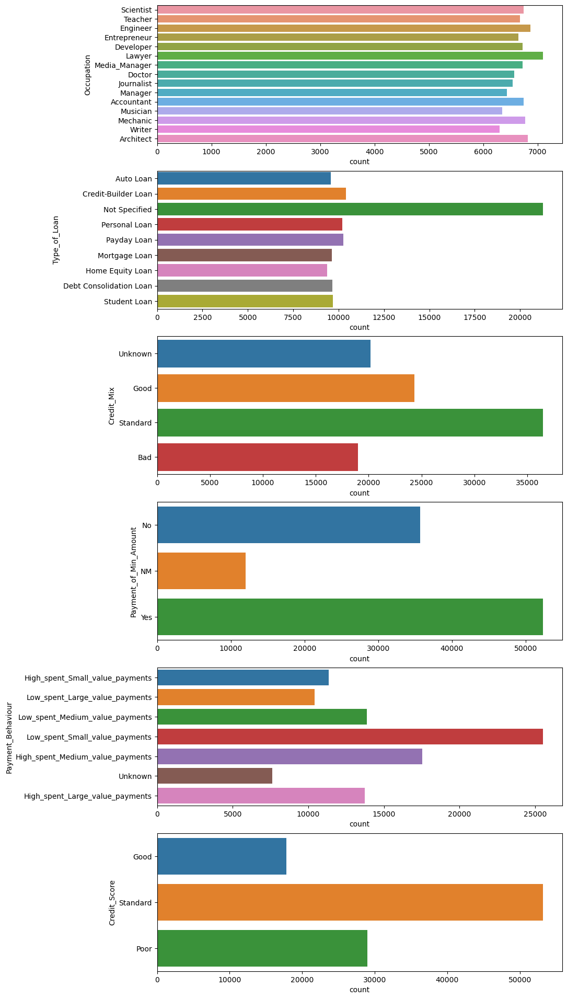

In [25]:
import matplotlib.pyplot as plt
import seaborn as sns

categorical_columns = [
    'Occupation',
    'Type_of_Loan',
    'Credit_Mix',
    'Payment_of_Min_Amount',
    'Payment_Behaviour',
    'Credit_Score'
]

fig, ax = plt.subplots(len(categorical_columns), 1,figsize=(10,24))
for i, feature in enumerate(categorical_columns):
    sns.countplot(data=cleaned_df, y=feature, ax=ax[i])
plt.show()

Berdasarkan visualisasi data di atas, terlihat beberapa kategori yang mendominasi dalam suatu feature. Hal ini perlu menjadi catatan tersendiri untuk kita terutama pada feature Credit_Scoring yang didominasi oleh kategori “Standard”. Fenomena ini sering disebut imbalance data yang berpotensi mengakibatkan terjadinya bias.

Oke, sekarang kita coba melihat visualisasi untuk feature numerik. Untuk melakukannya, kita akan menggunakan helper function yang kita gunakan pada contoh proyek sebelumnya.

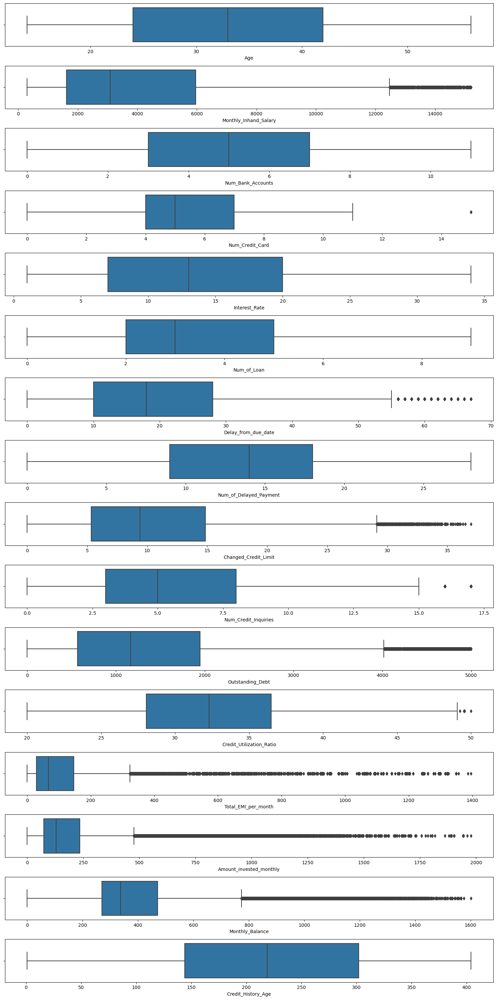

In [26]:
def numerical_dis_plot(features, df, segment_feature=None, showfliers=True):
    fig, ax = plt.subplots(len(features), 1,figsize=(15,30))
    for i, feature in enumerate(features):
        if segment_feature:
            sns.boxplot(y=segment_feature, x=feature, data=df, ax=ax[i], showfliers=showfliers)
            ax[i].set_ylabel(None)
        else:
            sns.boxplot(x=feature, data=df, ax=ax[i], showfliers=showfliers)
    plt.tight_layout()
    plt.show()

numerical_dis_plot(
    features=numerical_columns,
    df=cleaned_df
)

Pada visualisasi data di atas terlihat beberapa feature yang memiliki outlier seperti pada feature Monthly_Inhand_Salary. Hal ini terjadi karena terdapat beberapa pelanggan yang memiliki pendapatan per bulan yang jauh lebih besar ketimbang pelanggan pada umumnya. Outlier seperti ini dapat kita abaikan terlebih dahulu.

Sekarang kita coba melihat distribusi feature numerik tersebut jika dikelompokkan berdasarkan Credit_Score.

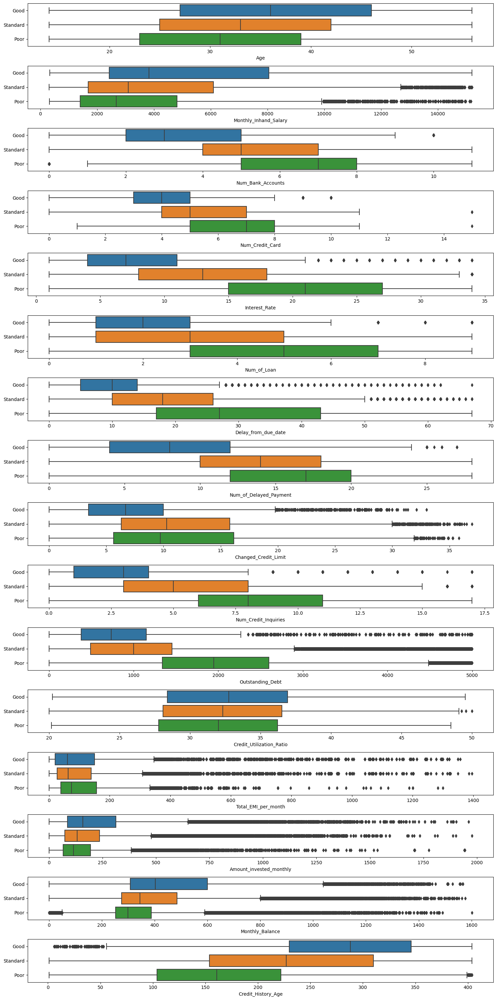

In [27]:
numerical_dis_plot(
    features=numerical_columns,
    df=cleaned_df,
    segment_feature="Credit_Score"
)

Pada visualisasi data di atas terlihat beberapa pola yang menarik seperti berikut.

- Pelanggan yang memiliki credit score baik (Good) cenderung memiliki umur yang lebih tua. Hal ini juga sejalan dengan usia riwayat kredit dari seorang pelanggan. Semakin besar usia riwayat kredit seorang pelanggan, semakin baik pula credit score yang dimiliki oleh pelanggan tersebut.  
- Pelanggan dengan credit score yang buruk (Poor) cenderung memiliki banyak akun bank, banyak kartu kredit, jumlah utang yang banyak, serta jumlah bunga kartu kredit yang tinggi. Selain itu, mereka juga cenderung untuk melakukan penunggakan pembayaran. Hal ini terlihat pada kolom Delay_from_due_date dan Num_of_Delayed_Payment.

Sekarang kita coba melihat distribusi feature kategorik berdasarkan berdasarkan Credit_Score. Untuk melakukannya, Anda dapat menggunakan kode berikut.

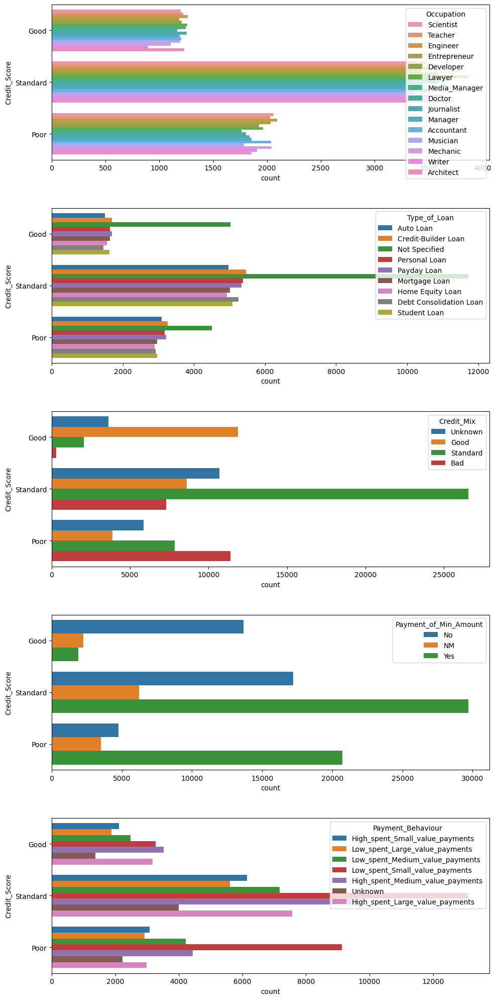

In [28]:
def categorical_plot(features, df, segment_feature=None):
    fig, ax = plt.subplots(len(features), 1,figsize=(10,20))
    for i, feature in enumerate(features):
        if segment_feature:
            sns.countplot(data=df, y=segment_feature, hue=feature, ax=ax[i])
        else:
            sns.countplot(data=df, x=feature, ax=ax[i])
    plt.tight_layout()
    plt.show()

categorical_plot(
    features=[
        'Occupation',
        'Type_of_Loan',
        'Credit_Mix',
        'Payment_of_Min_Amount',
        'Payment_Behaviour'
    ],
    df=cleaned_df,
    segment_feature="Credit_Score"
)

Pada visualisasi data di atas, terdapat beberapa pola menarik antara lain seperti di bawah ini.

- Pelanggan dengan credit score baik (Good) memiliki kemampuan dalam mengelola kredit secara baik. Hal ini terlihat pada kolom Credit_Mix.
- Pelanggan dengan credit score yang buruk (Poor) dan standar cenderung hanya melakukan pembayaran dengan jumlah minimum seperti yang terlihat pada kolom Payment_of_Min_Amount.
- Pelanggan dengan credit score yang buruk (Poor) dan standar, biasanya memiliki profil “Low_spent_Small_value_payments” pada feature Payment_Behaviour.

Oke, sekarang kita telah menemukan pola menarik yang terdapat dalam dataset. Untuk melengkapi proses EDA ini, kita coba melihat korelasi antar feature numerik. Proses ini dapat dilakukan menggunakan contoh kode berikut.

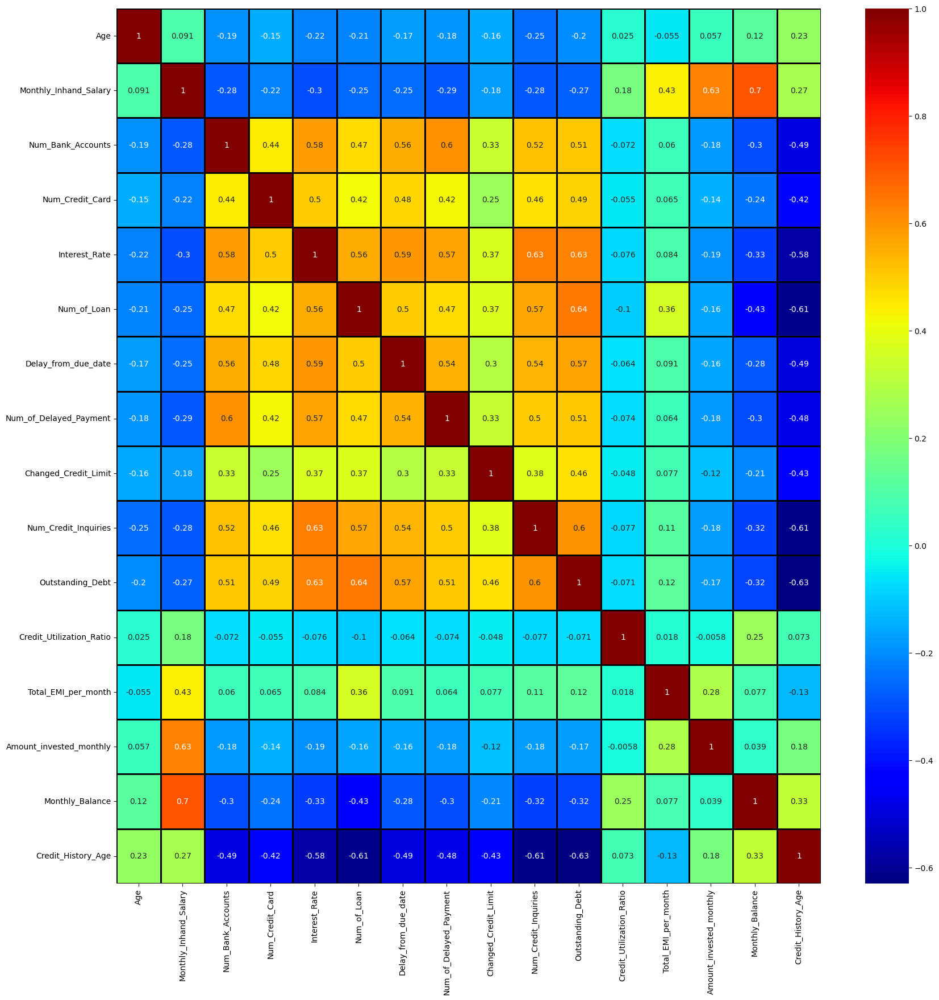

In [29]:
plt.figure(figsize=(20,20))
sns.heatmap(new_df[numerical_columns].corr(), annot=True, cmap='jet', linecolor='black', linewidth=1)
plt.show()

Pada visualisasi data di atas, terlihat beberapa fitur yang saling berkorelasi secara positif maupun negatif. Hal ini menandakan adanya multikolinearitas pada dataset yang kita miliki. Masalah multikolinearitas ini akan kita selesaikan pada tahap data preprocessing.

# Data Preprocessing

## Train-test Split

Pada proyek ini, kita akan membagi dataset dengan proporsi 95:5 artinya kita akan memiliki 95.000 sampel latih dan 5.000 sampel uji.

Namun, sebelum membagi dataset ke dalam data latih dan uji, kita perlu membuang beberapa kolom yang tidak akan kita gunakan untuk melatih model. Berikut merupakan kode untuk melakukannya.

In [30]:
new_cleaned_df = cleaned_df.drop(columns=['Customer_ID', 'Month', 'Occupation', 'Type_of_Loan', 'Credit_Utilization_Ratio'], axis=1)
new_cleaned_df.head()

,Age,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score
0,23.0,1824.843333,3.0,4.0,3.0,4.0,3.0,7.0,11.27,4.0,Unknown,809.98,265.0,No,49.574949,80.415295,High_spent_Small_value_payments,312.494089,Good
1,23.0,1824.843333,3.0,4.0,3.0,4.0,0.0,6.0,11.27,4.0,Good,809.98,265.0,No,49.574949,118.280222,Low_spent_Large_value_payments,284.629162,Good
2,23.0,1824.843333,3.0,4.0,3.0,4.0,3.0,7.0,11.27,4.0,Good,809.98,267.0,No,49.574949,81.699521,Low_spent_Medium_value_payments,331.209863,Good
3,23.0,1824.843333,3.0,4.0,3.0,4.0,5.0,4.0,6.27,4.0,Good,809.98,268.0,No,49.574949,199.458074,Low_spent_Small_value_payments,223.451310,Good
4,23.0,1824.843333,3.0,4.0,3.0,4.0,6.0,6.0,11.27,4.0,Good,809.98,269.0,No,49.574949,41.420153,High_spent_Medium_value_payments,341.489231,Good


Nah, sekarang kita bisa membagi dataframe new_cleaned_df ke dalam dua kelompok yaitu train_df dan test_df. Proses ini akan dilakukan dengan bantuan function train_test_split() yang disediakan oleh library scikit learn seperti pada contoh kode berikut.

In [31]:
from sklearn.model_selection import train_test_split

train_df, test_df = train_test_split(new_cleaned_df, test_size=0.05, random_state=42, shuffle=True)
train_df.reset_index(drop=True, inplace=True)
test_df.reset_index(drop=True, inplace=True)

print(train_df.shape)
print(test_df.shape)

(95000, 19)
(5000, 19)


## Undersampling

Pada proses EDA sebelumnya, kita menemukan fakta bahwa feature Credit_Score dalam dataset yang kita miliki didominasi oleh kategori “Standard”. Anda dapat memvalidasinya menggunakan kode berikut.

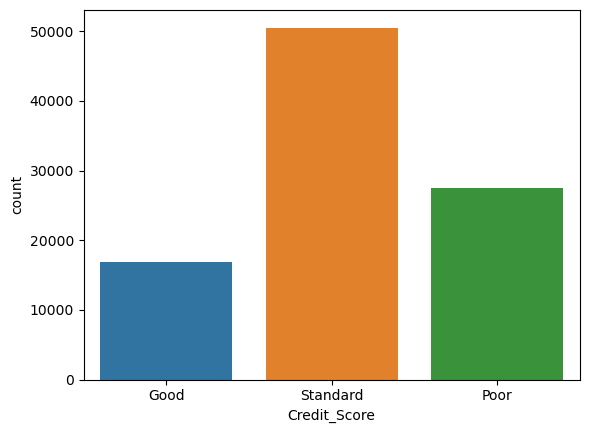

In [32]:
sns.countplot(data=train_df, x="Credit_Score")
plt.show()

Pada visualisasi data di atas, terlihat bahwa data latih yang kita miliki didominasi oleh kategori “Standard”. Ia menunjukkan terjadinya imbalance data dalam data latih yang kita miliki. Hal ini sangat berbahaya karena berpotensi menghasilkan bias sehingga membuat model cenderung memprediksi kelas atau kategori yang dominan (mayoritas).

Terdapat dua teknik yang umum digunakan untuk menangani imbalance data yaitu oversampling dan undersampling. Pada teknik oversampling, kita akan memperbanyak data dari kelas minoritas dengan cara membuat salinan secara acak dari data yang sudah ada hingga jumlahnya sama dengan kelas mayoritas. Berbanding terbalik dengan hal tersebut, pada teknik undersampling, kita akan mengurangi jumlah data pada kelas mayoritas secara acak sehingga jumlahnya sama dengan kelas minoritas.

Pada proyek ini, kita akan menerapkan teknik undersampling untuk menangani imbalanced data yang terdapat dalam data latih. Hal ini dilakukan karena kita memiliki jumlah data yang sangat banyak dan ingin menghindari duplikasi data.

Tahap berikutnya yang harus kita lakukan adalah mengelompokkan data yang mengandung kelas mayoritas dan minoritas. Anda dapat menggunakan kode berikut untuk melakukannya.

In [33]:
df_majority_1 = train_df[(train_df.Credit_Score == "Standard")]
df_majority_2 = train_df[(train_df.Credit_Score == "Poor")]
df_minority = train_df[(train_df.Credit_Score == "Good")]

Nah, setelah memisahkan data yang mengandung kelas mayoritas dan minoritas, sekarang kita bisa melakukan proses resampling (mengambil sampel dari sampel data yang sudah ada). Proses ini dilakukan menggunakan bantuan function resample() yang disediakan oleh scikit learn. Berikut merupakan contoh kode untuk melakukannya.

In [34]:
from sklearn.utils import resample

df_majority_1_undersampled = resample(df_majority_1, n_samples=16936, random_state=42)
df_majority_2_undersampled = resample(df_majority_2, n_samples=16936, random_state=42)
print(df_majority_1_undersampled.shape)
print(df_majority_2_undersampled.shape)

(16936, 19)
(16936, 19)


Pada kode di atas, kita melakukan resampling pada setiap data yang mengandung kelas mayoritas. Jumlah sampel yang diambil secara acak adalah sebanyak 16.936 sesuai dengan jumlah sampel pada kelas minoritas. Berikut merupakan keluaran dari kode tersebut.

Nah, sekarang kita tinggal menggabungkan kembali seluruh data tersebut. Selain itu, kita juga perlu memastikan data gabungan tersebut diacak menggunakan function shuffle() yang terdapat pada library scikit learn. Berikut merupakan contoh kode untuk melakukannya.

In [35]:
from sklearn.utils import shuffle

undersampled_train_df = pd.concat([df_minority, df_majority_1_undersampled]).reset_index(drop=True)
undersampled_train_df = pd.concat([undersampled_train_df, df_majority_2_undersampled]).reset_index(drop=True)
undersampled_train_df = shuffle(undersampled_train_df, random_state=42)
undersampled_train_df.reset_index(drop=True, inplace=True)
undersampled_train_df.sample(5)

,Age,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score
1962,18.0,3056.409167,4.0,5.0,10.0,3.0,23.0,0.0,2.35,4.0,Good,1319.24,387.0,No,73.346259,367.529577,Low_spent_Small_value_payments,154.765081,Poor
17283,33.0,2577.507500,7.0,5.0,9.0,1.0,7.0,17.0,1.74,5.0,Good,401.31,374.0,No,25.435614,57.012089,High_spent_Small_value_payments,435.303047,Good
45119,51.0,2312.900000,5.0,7.0,20.0,0.0,23.0,11.0,15.28,4.0,Unknown,179.10,184.0,Yes,0.000000,122.588450,Low_spent_Small_value_payments,398.701550,Standard
7924,15.0,1073.109583,8.0,4.0,10.0,6.0,13.0,17.0,7.67,8.0,Standard,471.00,136.0,Yes,61.629080,48.074917,High_spent_Small_value_payments,257.606961,Standard
43886,21.0,1715.193333,10.0,5.0,24.0,4.0,44.0,24.0,6.63,9.0,Unknown,2496.93,169.0,Yes,48.054054,68.549153,High_spent_Small_value_payments,314.916126,Standard


Untuk memvalidasi bahwa data tersebut telah balanced, kita bisa menggunakan kode berikut.

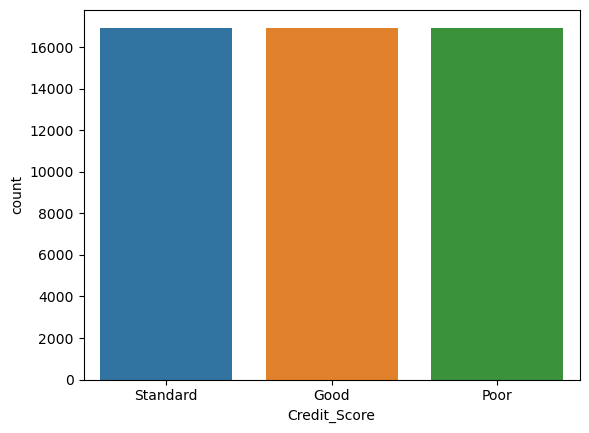

In [36]:
sns.countplot(data=undersampled_train_df, x="Credit_Score")
plt.show()

## Encoding dan Scaling

Encoding merupakan proses untuk membuat sebuah indeks dalam bentuk bilangan bulat yang mewakili kategori tertentu dalam sebuah feature kategorik. Proses ini perlu dilakukan karena model machine learning hanya mampu memproses data dalam bentuk numerik.

Selain melakukan encoding terhadap feature kategorik, kita juga perlu melakukan scaling pada feature numerik. Scaling merupakan proses pengubahan skala pada data numerik. Proses ini dilakukan agar seluruh feature numerik memiliki skala yang terstandarisasi. Hal ini dapat meningkatkan efisiensi dalam proses pelatihan model nantinya.

Sebelum melakukan encoding dan scaling, kita perlu memisahkan antara feature training (X) dan target (Y). Proses ini dapat Anda lakukan dengan menjalankan kode berikut.

In [37]:
X_train = undersampled_train_df.drop(columns="Credit_Score", axis=1)
y_train = undersampled_train_df["Credit_Score"]

X_test = test_df.drop(columns="Credit_Score", axis=1)
y_test = test_df["Credit_Score"]

Oke, setelah berhasil memisahkan feature training dan target, kini saatnya kita melakukan proses encoding dan scaling terhadap feature training. Pada proyek ini, proses encoding dan scaling akan dilakukan menggunakan kedua helper function berikut.

In [38]:
import os
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import MinMaxScaler
import joblib

def scaling(features, df, df_test=None):
    # Pastikan folder 'model/' ada
    os.makedirs("model", exist_ok=True)

    if df_test is not None:
        df = df.copy()
        df_test = df_test.copy()
        for feature in features:
            scaler = MinMaxScaler()
            X = np.asanyarray(df[feature])
            X = X.reshape(-1, 1)
            scaler.fit(X)
            df[feature] = scaler.transform(X)
            joblib.dump(scaler, f"model/scaler_{feature}.joblib")

            X_test = np.asanyarray(df_test[feature])
            X_test = X_test.reshape(-1, 1)
            df_test[feature] = scaler.transform(X_test)
        return df, df_test
    else:
        df = df.copy()
        for feature in features:
            scaler = MinMaxScaler()
            X = np.asanyarray(df[feature])
            X = X.reshape(-1, 1)
            scaler.fit(X)
            df[feature] = scaler.transform(X)
            joblib.dump(scaler, f"model/scaler_{feature}.joblib")
        return df

def encoding(features, df, df_test=None):
    # Pastikan folder 'model/' ada
    os.makedirs("model", exist_ok=True)

    if df_test is not None:
        df = df.copy()
        df_test = df_test.copy()
        for feature in features:
            encoder = LabelEncoder()
            encoder.fit(df[feature])
            df[feature] = encoder.transform(df[feature])
            joblib.dump(encoder, f"model/encoder_{feature}.joblib")

            df_test[feature] = encoder.transform(df_test[feature])
        return df, df_test
    else:
        df = df.copy()
        for feature in features:
            encoder = LabelEncoder()
            encoder.fit(df[feature])
            df[feature] = encoder.transform(df[feature])
            joblib.dump(encoder, f"model/encoder_{feature}.joblib")
        return df


Function scaling() digunakan untuk melakukan proses scaling dengan metode Min-max scaling (memanfaatkan MinMaxScaler() dari scikit learn). Ia merupakan metode scaling menggunakan nilai minimum dan maksimum yang terdapat dalam sebuah feature dan mengubah data dalam feature tersebut ke dalam skala 0-1. Selain itu, function ini juga akan menyimpan object yang digunakan untuk melakukan proses scaling pada setiap feature dalam sebuah berkas dengan format .joblib. Berkas ini akan sangat berguna untuk menjalankan proses data preprocessing dalam lingkup produksi atau deployment.

Pada function encoding(), kita akan melakukan proses encoding pada seluruh feature kategorik dengan bantuan LabelEncoder() dari scikit learn. Pada function ini juga kita akan menyimpan setiap object yang digunakan untuk melakukan proses scaling pada suatu feature kategorik. Tujuannya agar proses ini dapat dilakukan dalam lingkup deployment dengan hasil yang konsisten.

Berikut merupakan contoh kode yang dapat Anda gunakan untuk menjalankan kedua helper function tersebut.

In [39]:
numerical_columns = [
    'Age',
    'Monthly_Inhand_Salary',
    'Num_Bank_Accounts',
    'Num_Credit_Card',
    'Interest_Rate',
    'Num_of_Loan',
    'Delay_from_due_date',
    'Num_of_Delayed_Payment',
    'Changed_Credit_Limit',
    'Num_Credit_Inquiries',
    'Outstanding_Debt',
    'Total_EMI_per_month',
    'Amount_invested_monthly',
    'Monthly_Balance',
    'Credit_History_Age'
]

categorical_columns = [
    'Credit_Mix',
    'Payment_of_Min_Amount',
    'Payment_Behaviour'
]

new_train_df, new_test_df = scaling(numerical_columns, X_train, X_test)
new_train_df, new_test_df = encoding(categorical_columns, new_train_df, new_test_df)

Kita masuk ke tahap berikutnya kita juga perlu melakukan encoding terhadap terhadap feature target pada data latih dan uji. Berikut merupakan contoh kode untuk melakukannya

In [40]:
encoder = LabelEncoder()
encoder.fit(y_train)
new_y_train = encoder.transform(y_train)
joblib.dump(encoder, "model/encoder_target.joblib")

new_y_test = encoder.transform(y_test)

Sekarang kita akan masuk tahap terakhir dalam proses data preprocessing yaitu menerapkan teknik PCA untuk mengurangi jumlah dimensi dan mengatasi multikolinearitas pada feature numerik. Yuk, kita lanjut!

## Principal Component Analysis (PCA)

Principal Component Analysis atau PCA merupakan salah satu teknik reduksi (pengurangan) dimensi yang umum digunakan di industri. Ia merupakan prosedur yang mengurangi jumlah fitur dengan tetap mempertahankan informasi pada data. PCA adalah teknik untuk mereduksi dimensi, mengekstraksi fitur, dan mentransformasi data dari “n-dimensional space” ke dalam sistem berkoordinat baru dengan dimensi m, di mana m lebih kecil dari n.

In [41]:
pca_numerical_columns_1 = [
    'Num_Bank_Accounts',
    'Num_Credit_Card',
    'Interest_Rate',
    'Num_of_Loan',
    'Delay_from_due_date',
    'Num_of_Delayed_Payment',
    'Changed_Credit_Limit',
    'Num_Credit_Inquiries',
    'Outstanding_Debt',
    'Credit_History_Age'
]

pca_numerical_columns_2 = [
    'Monthly_Inhand_Salary',
    'Monthly_Balance',
    'Amount_invested_monthly',
    'Total_EMI_per_month'
]

Setelah mengelompokkan feature yang saling berkorelasi, kita perlu menyiapkan sebuah dataframe baru yang nantinya akan menampung hasil dari proses PCA. Berikut merupakan kode untuk melakukannya.

In [42]:
train_pca_df = new_train_df.copy().reset_index(drop=True)
test_pca_df = new_test_df.copy().reset_index(drop=True)

In [43]:
train_pca_df.isnull().sum()

Age                        0
Monthly_Inhand_Salary      0
Num_Bank_Accounts          0
Num_Credit_Card            0
Interest_Rate              0
Num_of_Loan                0
Delay_from_due_date        0
Num_of_Delayed_Payment     0
Changed_Credit_Limit       0
Num_Credit_Inquiries       0
Credit_Mix                 0
Outstanding_Debt           0
Credit_History_Age         0
Payment_of_Min_Amount      0
Total_EMI_per_month        0
Amount_invested_monthly    0
Payment_Behaviour          0
Monthly_Balance            0
dtype: int64

Oke, sekarang kita telah siap melakukan proses PCA terhadap kelompok feature pertama. Untuk melakukan proses PCA, pertama kita perlu mencari jumlah komponen utama yang paling optimal. Untuk melakukannya, Anda dapat menggunakan kode berikut.

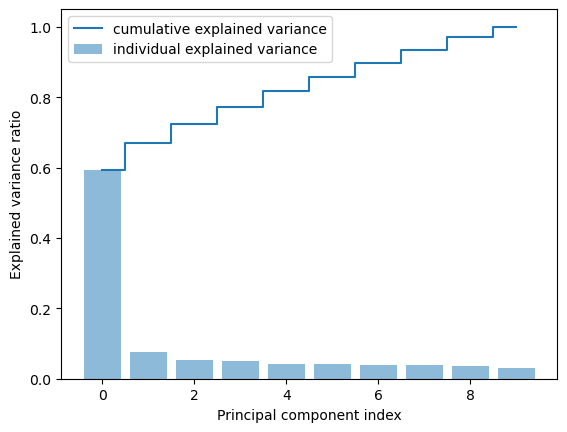

In [44]:
from sklearn.decomposition import PCA

pca = PCA(n_components=len(pca_numerical_columns_1), random_state=42)
pca.fit(train_pca_df[pca_numerical_columns_1])
princ_comp = pca.transform(train_pca_df[pca_numerical_columns_1])

var_exp = pca.explained_variance_ratio_.round(3)
cum_var_exp = np.cumsum(var_exp)

plt.bar(range(len(pca_numerical_columns_1)), var_exp, alpha=0.5, align='center', label='individual explained variance')
plt.step(range(len(pca_numerical_columns_1)), cum_var_exp, where='mid', label='cumulative explained variance')
plt.ylabel('Explained variance ratio')
plt.xlabel('Principal component index')
plt.legend(loc='best')
plt.show()

Gambar di atas menunjukkan visualisasi jumlah varians untuk setiap jumlah komponen utama. Berdasarkan gambar tersebut terlihat bahwa, dengan hanya mengambil 5 komponen utama kita telah memperoleh lebih dari 80% varians. Ini berarti kita bisa mewakili seluruh kelompok feature tersebut (ada 9 feature) hanya dengan 5 komponen utama.

Nah, sekarang kita coba melakukan proses PCA kembali dengan jumlah komponen utama sebanyak 5. Kemudian, kita akan mengganti kelompok feature asli dengan 5 komponen utama dari proses PCA. Berikut merupakan kode yang digunakan untuk melakukan seluruh proses tersebut.

In [45]:
pca_1 = PCA(n_components=5, random_state=42)
pca_1.fit(train_pca_df[pca_numerical_columns_1])
joblib.dump(pca_1, "model/pca_{}.joblib".format(1))
princ_comp_1 = pca_1.transform(train_pca_df[pca_numerical_columns_1])
train_pca_df[["pc1_1", "pc1_2", "pc1_3", "pc1_4", "pc1_5"]] = pd.DataFrame(princ_comp_1, columns=["pc1_1", "pc1_2", "pc1_3", "pc1_4", "pc1_5"])
train_pca_df.drop(columns=pca_numerical_columns_1, axis=1, inplace=True)
train_pca_df.head()

,Age,Monthly_Inhand_Salary,Credit_Mix,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,pc1_1,pc1_2,pc1_3,pc1_4,pc1_5
0,0.690476,0.237662,2,2,0.113024,0.025093,0,0.266400,0.215967,-0.335006,0.056187,-0.047697,0.147047
1,0.190476,0.503576,1,1,0.111900,0.080054,0,0.451454,-0.319090,-0.112741,0.227276,-0.055502,0.117496
2,0.428571,0.090128,1,1,0.033189,0.021363,3,0.221049,-0.419284,-0.069814,0.232473,0.110948,0.250861
3,0.476190,0.126136,1,0,0.060780,0.020599,0,0.212522,-0.257280,0.237472,0.376891,0.068669,0.012678
4,0.452381,0.104396,1,1,0.050268,0.082627,5,0.155497,-0.502601,-0.073807,0.226035,0.284458,-0.015841


Kode tersebut akan menghasilkan data latih seperti berikut. Selain itu, ia juga menyimpan object PCA ini dalam berkas pca_1.joblib.

Oke, sekarang kita akan melakukan proses yang sama untuk kelompok data berikutnya. Berikut merupakan contoh kode untuk melakukan proses tersebut.

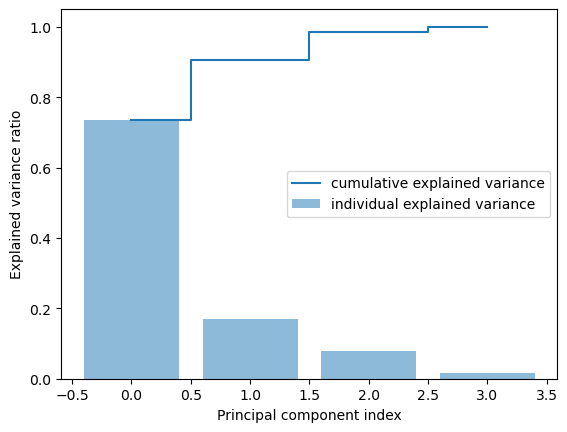

In [46]:
pca = PCA(n_components=len(pca_numerical_columns_2), random_state=42)
pca.fit(train_pca_df[pca_numerical_columns_2])
princ_comp = pca.transform(train_pca_df[pca_numerical_columns_2])

var_exp = pca.explained_variance_ratio_.round(3)
cum_var_exp = np.cumsum(var_exp)

plt.bar(range(len(pca_numerical_columns_2)), var_exp, alpha=0.5, align='center', label='individual explained variance')
plt.step(range(len(pca_numerical_columns_2)), cum_var_exp, where='mid', label='cumulative explained variance')
plt.ylabel('Explained variance ratio')
plt.xlabel('Principal component index')
plt.legend(loc='best')
plt.show()

Berdasarkan grafik tersebut terlihat bahwa hanya dengan menggunakan 2 komponen utama kita telah memperoleh 90% varians. Hal ini berarti kita bisa mewakili sebagian besar informasi dari seluruh feature pada kelompok ini (ada 4 feature) hanya menggunakan dua komponen utama.

Kemudian kita dapat melakukan proses PCA kembali dengan jumlah komponen utama sebanyak 2. Lalu, mengganti kelompok feature tersebut dengan 2 komponen utama dari proses PCA. Berikut merupakan contoh kode untuk melakukannya.

In [47]:
pca_2 = PCA(n_components=2, random_state=42)
pca_2.fit(train_pca_df[pca_numerical_columns_2])
joblib.dump(pca_2, "model/pca_{}.joblib".format(2))
princ_comp_2 = pca_2.transform(train_pca_df[pca_numerical_columns_2])
train_pca_df[["pc2_1", "pc2_2"]] = pd.DataFrame(princ_comp_2, columns=["pc2_1", "pc2_2"])
train_pca_df.drop(columns=pca_numerical_columns_2, axis=1, inplace=True)
train_pca_df.head()

,Age,Credit_Mix,Payment_of_Min_Amount,Payment_Behaviour,pc1_1,pc1_2,pc1_3,pc1_4,pc1_5,pc2_1,pc2_2
0,0.690476,2,2,0,0.215967,-0.335006,0.056187,-0.047697,0.147047,-0.041153,-0.042993
1,0.190476,1,1,0,-0.319090,-0.112741,0.227276,-0.055502,0.117496,0.278922,-0.109200
2,0.428571,1,1,3,-0.419284,-0.069814,0.232473,0.110948,0.250861,-0.200170,-0.056832
3,0.476190,1,0,0,-0.257280,0.237472,0.376891,0.068669,0.012678,-0.168846,-0.037691
4,0.452381,1,1,5,-0.502601,-0.073807,0.226035,0.284458,-0.015841,-0.198205,0.034669


Wah, sekarang kita hanya memiliki 11 feature (awalnya terdapat 19 feature) yang akan digunakan untuk melatih model machine learning. Oh iya, jangan lupa untuk melakukan hal yang sama untuk data uji dengan kode seperti berikut.

In [48]:
test_princ_comp_1 = pca_1.transform(test_pca_df[pca_numerical_columns_1])
test_pca_df[["pc1_1", "pc1_2", "pc1_3", "pc1_4", "pc1_5"]] = pd.DataFrame(test_princ_comp_1, columns=["pc1_1", "pc1_2", "pc1_3", "pc1_4", "pc1_5"])
test_pca_df.drop(columns=pca_numerical_columns_1, axis=1, inplace=True)

test_princ_comp_1 = pca_2.transform(test_pca_df[pca_numerical_columns_2])
test_pca_df[["pc2_1", "pc2_2"]] = pd.DataFrame(test_princ_comp_1, columns=["pc2_1", "pc2_2"])
test_pca_df.drop(columns=pca_numerical_columns_2, axis=1, inplace=True)
test_pca_df.head()

,Age,Credit_Mix,Payment_of_Min_Amount,Payment_Behaviour,pc1_1,pc1_2,pc1_3,pc1_4,pc1_5,pc2_1,pc2_2
0,0.380952,1,1,0,-0.587977,-0.065733,-0.240664,0.074134,0.170567,-0.029592,-0.141671
1,0.095238,0,2,5,0.760531,-0.286918,-0.114280,-0.250767,0.198645,-0.239788,0.016467
2,0.642857,1,1,5,-0.441124,-0.204247,-0.141170,-0.030998,-0.200501,0.627704,0.211694
3,0.500000,2,2,5,0.360242,0.118104,-0.383711,0.236119,-0.240762,-0.196577,-0.059574
4,0.309524,1,1,1,-0.504527,-0.468683,-0.080164,0.094325,-0.195725,0.255807,-0.113497


Berdasarkan data yang kita miliki, target keluaran yang diharapkan adalah mengelompokkan pelanggan yang mengajukan pinjaman ke dalam tiga kategori yaitu Good, Standard, dan Poor.



Pada proyek ini, kita akan mengembangkan beberapa model menggunakan algoritma machine learning yang berbeda-beda. Kemudian, kita akan mengevaluasi performa masing-masing model lalu menentukan model mana yang memiliki performa terbaik. Nah, berikut merupakan beberapa algoritma yang akan kita gunakan.

- Decision tree
- Random forest
- Gradient Boosting

# Grid Search

Untuk menerapkan algoritma ini, kita akan menggunakan tool yang disediakan oleh scikit learn yang bernama GridSearchCV(). Ketika dipanggil, tool ini akan menerima berapa parameter seperti

- estimator: parameter yang menampung model object;
- param_grid: kumpulan hyperparameter yang akan digunakan untuk membuat grid search;
- cv: parameter untuk mengatur proses cross validation; dan
- n_jobs: jumlah job (pekerjaan) yang dikerjakan secara paralel. n_jobs=-1 artinya semua proses berjalan secara paralel.

In [95]:
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import GridSearchCV

param_grid = {
    "penalty": ["l1","l2"],
    "C": [0.01, 0.1, 1]
}

log_model = LogisticRegression(random_state=123)

CV_lr = GridSearchCV(estimator=log_model, param_grid=param_grid, cv=5, n_jobs=-1)
CV_lr.fit(train_pca_df, new_y_train)

/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:540: FitFailedWarning: 
15 fits failed out of a total of 30.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
15 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 888, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/base.py", line 1473, in wrapper
    return fit_method(estimator, *args, **kwargs)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py", line 1194, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/us

GridSearchCV(cv=5, estimator=LogisticRegression(random_state=123), n_jobs=-1,
             param_grid={'C': [0.01, 0.1, 1], 'penalty': ['l1', 'l2']})

Pada kode di atas, kita melakukan proses hyperparameter tuning dengan grid search untuk model logistic regression. Terlihat pada bagian param_grid, kita memuat beberapa hyperparameter yang terdapat pada algoritma logistic regression seperti penalty dan C. Keduanya digunakan untuk mengatur proses regularization (teknik untuk mengurangi overfitting) yang terdapat dalam algoritma tersebut.

# Decision Tree

Pada library scikit learn. Anda dapat menggunakan function DecisionTreeClassifier() untuk membuat dan melatih model decision tree yang mampu menyelesaikan permasalahan klasifikasi. Model menerima beberapa parameter seperti berikut.

- random_state: digunakan untuk mengontrol random number generator yang digunakan oleh model.
- max_depth: hyperparameter yang mengatur kedalaman atau panjang pohon keputusan.
- max_features: hyperparameter yang mengatur jumlah maksimum feature yang digunakan untuk mencari percabangan terbaik.
- criterion: metrik yang digunakan untuk mengukur kualitas dari sebuah percabangan.

In [96]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import GridSearchCV

tree_model = DecisionTreeClassifier(random_state=123)

param_grid = {
    'max_features': ['auto', 'sqrt', 'log2'],
    'max_depth' : [5, 6, 7, 8],
    'criterion' :['gini', 'entropy']
}

CV_tree = GridSearchCV(estimator=tree_model, param_grid=param_grid, cv=5, n_jobs=-1)
CV_tree.fit(train_pca_df, new_y_train)

/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:540: FitFailedWarning: 
40 fits failed out of a total of 120.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
22 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 888, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/base.py", line 1466, in wrapper
    estimator._validate_params()
  File "/usr/local/lib/python3.10/dist-packages/sklearn/base.py", line 666, in _validate_params
    validate_parameter_constraints(
  File "/usr/local/lib/python3.10/dist-packages/sklearn/utils/

GridSearchCV(cv=5, estimator=DecisionTreeClassifier(random_state=123),
             n_jobs=-1,
             param_grid={'criterion': ['gini', 'entropy'],
                         'max_depth': [5, 6, 7, 8],
                         'max_features': ['auto', 'sqrt', 'log2']})

In [97]:
print("best parameters: ", CV_tree.best_params_)

best parameters:  {'criterion': 'entropy', 'max_depth': 8, 'max_features': 'sqrt'}


Nah, itulah hyperparameter yang akan kita gunakan untuk membuat model decision tree. Berikut merupakan kode untuk membuat dan melatih model decision tree dengan hyperparameter terbaik.

In [98]:
tree_model = DecisionTreeClassifier(
    random_state=123,
    criterion='entropy',
    max_depth=8,
    max_features='sqrt'
)

tree_model.fit(train_pca_df, new_y_train)
joblib.dump(tree_model, "model/tree_model.joblib")

['model/tree_model.joblib']

# Random Forest

Untuk membuat model random forest untuk persoalan klasifikasi, kita bisa menggunakan tool RandomForestClassifier() yang telah disediakan oleh scikit learn. Ia menerima beberapa parameter seperti berikut.

- random_state: digunakan untuk mengontrol random number generator yang digunakan oleh model.
- max_depth: hyperparameter yang mengatur kedalaman atau panjang pohon keputusan.
- max_features: hyperparameter yang mengatur jumlah maksimum feature yang digunakan untuk mencari percabangan terbaik.
- criterion: metrik yang digunakan untuk mengukur kualitas dari sebuah percabangan.
- n_estimators: hyperparameter yang menentukan jumlah trees (pohon) yang digunakan dalam algoritma random forest.

In [99]:
from sklearn.ensemble import RandomForestClassifier

rdf_model = RandomForestClassifier(random_state=42)

param_grid = {
    'n_estimators': [200, 500],
    'max_features': ['auto', 'sqrt', 'log2'],
    'max_depth' : [6, 7, 8],
    'criterion' :['gini', 'entropy']
}

CV_rdf = GridSearchCV(estimator=rdf_model, param_grid=param_grid, cv=5, n_jobs=-1)
CV_rdf.fit(train_pca_df, new_y_train)

/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:540: FitFailedWarning: 
60 fits failed out of a total of 180.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
37 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 888, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/base.py", line 1466, in wrapper
    estimator._validate_params()
  File "/usr/local/lib/python3.10/dist-packages/sklearn/base.py", line 666, in _validate_params
    validate_parameter_constraints(
  File "/usr/local/lib/python3.10/dist-packages/sklearn/utils/

GridSearchCV(cv=5, estimator=RandomForestClassifier(random_state=42), n_jobs=-1,
             param_grid={'criterion': ['gini', 'entropy'],
                         'max_depth': [6, 7, 8],
                         'max_features': ['auto', 'sqrt', 'log2'],
                         'n_estimators': [200, 500]})

Sama seperti sebelumnya, Anda dapat memperoleh hyperparameter terbaik dengan menjalankan kode berikut.

In [100]:
print("best parameters: ", CV_rdf.best_params_)

best parameters:  {'criterion': 'gini', 'max_depth': 8, 'max_features': 'sqrt', 'n_estimators': 200}


Nah, sekarang kita akan membuat dan melatih model random forest menggunakan hyperparameter di atas. Berikut merupakan kode untuk melakukannya.

In [101]:
rdf_model = RandomForestClassifier(
    random_state=123,
    max_depth=8,
    n_estimators=200,
    max_features='sqrt',
    criterion='gini',
    n_jobs=-1
)
rdf_model.fit(train_pca_df, new_y_train)
joblib.dump(rdf_model, "model/rdf_model.joblib")

['model/rdf_model.joblib']

# Gradient Boosting

Nah, untuk membuat model dengan algoritma gradient boosting, kita bisa menggunakan GradientBoostingClassifier() yang juga disediakan oleh scikit learn. Ia menerima beberapa parameter seperti berikut.

- random_state: digunakan untuk mengontrol random number generator yang digunakan oleh model.
- max_depth: hyperparameter yang mengatur kedalaman atau panjang pohon keputusan.
- max_features: hyperparameter yang mengatur jumlah maksimum feature yang digunakan untuk mencari percabangan terbaik.
- n_estimators: hyperparameter yang menentukan jumlah trees (pohon) yang akan digunakan.

In [102]:
from sklearn.ensemble import GradientBoostingClassifier

gboost_model = GradientBoostingClassifier(random_state=123)

param_grid = {
    'max_depth': [5, 8],
    'n_estimators': [200, 300],
    'learning_rate': [0.01, 0.1],
    'max_features': ['auto', 'sqrt', 'log2']
}

CV_gboost = GridSearchCV(estimator=gboost_model, param_grid=param_grid, cv=5, n_jobs=-1)
CV_gboost.fit(train_pca_df, new_y_train)

/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:540: FitFailedWarning: 
40 fits failed out of a total of 120.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
40 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 888, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/base.py", line 1466, in wrapper
    estimator._validate_params()
  File "/usr/local/lib/python3.10/dist-packages/sklearn/base.py", line 666, in _validate_params
    validate_parameter_constraints(
  File "/usr/local/lib/python3.10/dist-packages/sklearn/utils/

GridSearchCV(cv=5, estimator=GradientBoostingClassifier(random_state=123),
             n_jobs=-1,
             param_grid={'learning_rate': [0.01, 0.1], 'max_depth': [5, 8],
                         'max_features': ['auto', 'sqrt', 'log2'],
                         'n_estimators': [200, 300]})

Sama seperti sebelumnya, Anda dapat memperoleh hyperparameter terbaik dengan menjalankan kode berikut.

In [103]:
print("best parameters: ", CV_gboost.best_params_)

best parameters:  {'learning_rate': 0.1, 'max_depth': 8, 'max_features': 'sqrt', 'n_estimators': 300}


Sekarang saatnya kita membuat model gradient boosting menggunakan hyperparameter di atas. Berikut merupakan kode untuk melakukannya.

In [49]:
from sklearn.ensemble import GradientBoostingClassifier

gboost_model = GradientBoostingClassifier(
    random_state=123,
    learning_rate=0.1,
    max_depth=8,
    max_features='sqrt',
    n_estimators=300
)
gboost_model.fit(train_pca_df, new_y_train)
joblib.dump(gboost_model, "model/gboost_model.joblib")

['model/gboost_model.joblib']

# Evaluation

Pada contoh proyek ini, kita akan mengevaluasi performa model menggunakan data uji (test) yang sebelumnya kita buat. Berikut merupakan helper function yang kita gunakan untuk mengevaluasi ketiga model yang sebelumnya telah kita latih.

In [105]:
from sklearn.metrics import classification_report, confusion_matrix

def evaluating(y_pred, y_true):
    '''Evaluasi model'''
    labels=['Good', 'Poor', 'Standard']

    print(classification_report(y_pred=y_pred, y_true=y_true))

    cnf_matrix = confusion_matrix(y_pred=y_pred, y_true=y_true, labels=labels)
    confusion_matrix_df = pd.DataFrame(cnf_matrix, labels, labels)
    sns.heatmap(confusion_matrix_df, annot=True, annot_kws={'size': 14}, fmt='d', cmap='YlGnBu')
    plt.ylabel('True label', fontsize=15)
    plt.xlabel('Predicted label', fontsize=15)
    plt.show()

    return confusion_matrix_df

Pada helper function di atas kita memanfaatkan dua buah function yang disediakan oleh scikit learn yaitu confusion_matrix() dan classification_report().

- confusion_matrix(): digunakan untuk menghasilkan confusion matrix dari hasil prediksi.
- classification_report(): digunakan untuk menghasilkan berbagai berbagai metrik untuk mengevaluasi model seperti accuracy, recall, precision, dan F1 score.

Oke, sekarang kita akan coba mengevaluasi model pertama yaitu decision tree. Untuk melakukannya, kita perlu membuat hasil prediksi dari data testing terlebih dahulu dengan menggunakan method predict(). Kemudian kita perlu mengubah hasil prediksi ke dalam label yang sesuai (Good, Poor, Standard) dengan menggunakan encoder.inverse_transform(). Berikut merupakan kode untuk melakukan seluruh proses tersebut.

In [106]:
y_pred_test = tree_model.predict(test_pca_df)
y_pred_test = encoder.inverse_transform(y_pred_test)

Kode di atas akan menghasilkan prediksi yang disimpan dalam variabel y_pred_train. Hasil ini selanjutnya akan dievaluasi menggunakan helper function evaluating() yang sebelumnya telah kita buat.

              precision    recall  f1-score   support

        Good       0.47      0.80      0.59       892
        Poor       0.63      0.64      0.63      1459
    Standard       0.77      0.59      0.66      2649

    accuracy                           0.64      5000
   macro avg       0.62      0.67      0.63      5000
weighted avg       0.68      0.64      0.64      5000



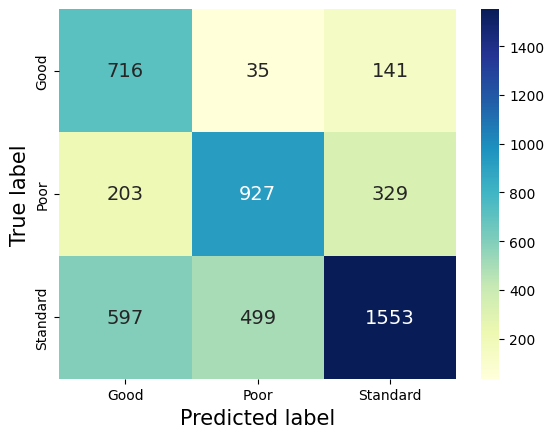

,Good,Poor,Standard
Good,716,35,141
Poor,203,927,329
Standard,597,499,1553


In [107]:
evaluating(y_pred=y_pred_test, y_true=y_test)

Sekarang kita melakukan tahapan yang sama persis untuk mengevaluasi model random forest. Berikut merupakan contoh kode untuk melakukannya.

              precision    recall  f1-score   support

        Good       0.50      0.82      0.62       892
        Poor       0.64      0.74      0.68      1459
    Standard       0.83      0.58      0.68      2649

    accuracy                           0.67      5000
   macro avg       0.66      0.71      0.66      5000
weighted avg       0.71      0.67      0.67      5000



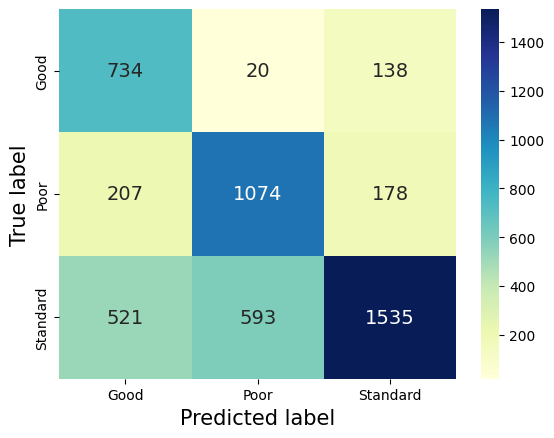

,Good,Poor,Standard
Good,734,20,138
Poor,207,1074,178
Standard,521,593,1535


In [108]:
y_pred_test = rdf_model.predict(test_pca_df)
y_pred_test = encoder.inverse_transform(y_pred_test)

evaluating(y_pred=y_pred_test, y_true=y_test)

Terakhir, kita juga perlu melakukan hal yang sama untuk mengevaluasi performa model gradient boosting dengan kode di bawah ini.

              precision    recall  f1-score   support

        Good       0.53      0.85      0.65       892
        Poor       0.68      0.73      0.71      1459
    Standard       0.83      0.62      0.71      2649

    accuracy                           0.70      5000
   macro avg       0.68      0.74      0.69      5000
weighted avg       0.73      0.70      0.70      5000



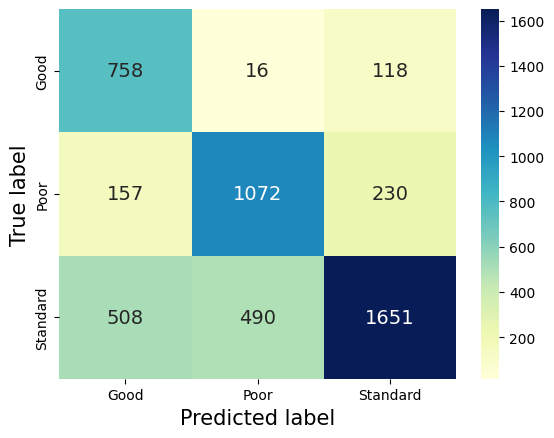

,Good,Poor,Standard
Good,758,16,118
Poor,157,1072,230
Standard,508,490,1651


In [109]:
y_pred_test = gboost_model.predict(test_pca_df)
y_pred_test = encoder.inverse_transform(y_pred_test)

evaluating(y_pred=y_pred_test, y_true=y_test)

Jadi, berdasarkan hasil evaluasi ini, dapat disimpulkan bahwa model dengan performa terbaik adalah gradient boosting. Model inilah yang akan kita gunakan dalam membuat prototype sederhana untuk mengidentifikasi risiko kredit pelanggan. Agar dapat digunakan kembali, kita perlu menyimpan model tersebut. Berikut merupakan contoh kode untuk melakukannya.

In [110]:
joblib.dump(gboost_model, "model/gboost_model.joblib")

['model/gboost_model.joblib']

Pada proses evaluasi, selain kita melihat performa dari setiap model, kita juga memeriksa feature utama yang digunakan oleh model dalam menghasilkan sebuah prediksi. Hal ini dilakukan untuk memahami alasan dibalik setiap prediksi. Untuk mengetahui feature utama tersebut, kita bisa memanfaatkan method feature_importances_ dari sebuah model. Berikut merupakan contoh kode untuk melakukannya.

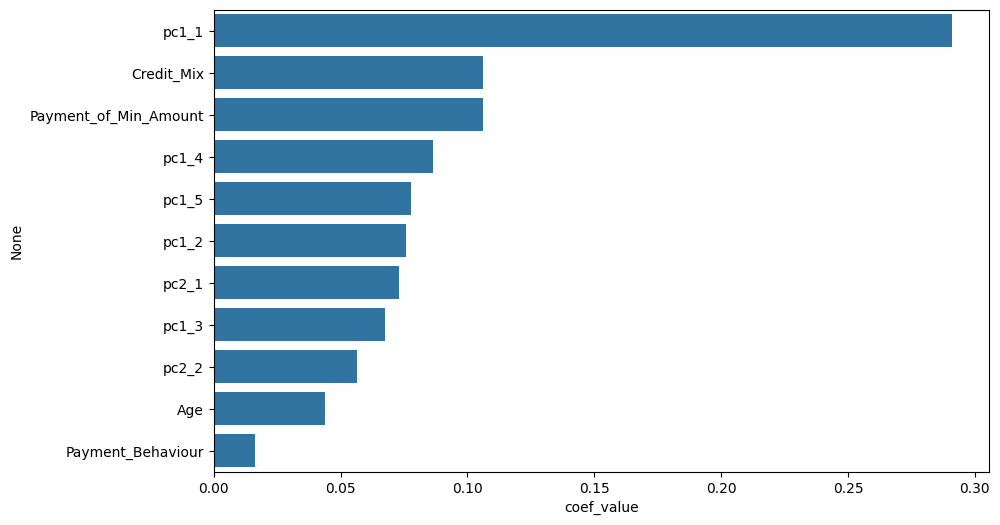

,coef_value
pc1_1,0.290927
Credit_Mix,0.106155
Payment_of_Min_Amount,0.106097
pc1_4,0.086249
pc1_5,0.077816
pc1_2,0.075847
pc2_1,0.072823
pc1_3,0.067547
pc2_2,0.056401
Age,0.043828


In [111]:
def plot_feature_importances(feature_importances, cols):
    features = pd.DataFrame(feature_importances, columns=['coef_value']).set_index(cols)
    features = features.sort_values(by='coef_value', ascending=False)
    top_features = features

    plt.figure(figsize=(10, 6))
    sns.barplot(x='coef_value', y=features.index, data=features)
    plt.show()
    return top_features

plot_feature_importances(gboost_model.feature_importances_, train_pca_df.columns)

In [112]:
!zip -r /content/model.zip /content/model

  adding: content/model/ (stored 0%)
  adding: content/model/scaler_Changed_Credit_Limit.joblib (deflated 41%)
  adding: content/model/scaler_Age.joblib (deflated 42%)
  adding: content/model/rdf_model.joblib (deflated 63%)
  adding: content/model/scaler_Monthly_Inhand_Salary.joblib (deflated 38%)
  adding: content/model/scaler_Num_of_Delayed_Payment.joblib (deflated 43%)
  adding: content/model/scaler_Num_Credit_Card.joblib (deflated 43%)
  adding: content/model/gboost_model.joblib (deflated 69%)
  adding: content/model/pca_1.joblib (deflated 26%)
  adding: content/model/scaler_Num_Bank_Accounts.joblib (deflated 43%)
  adding: content/model/pca_2.joblib (deflated 35%)
  adding: content/model/encoder_Payment_Behaviour.joblib (deflated 39%)
  adding: content/model/encoder_target.joblib (deflated 28%)
  adding: content/model/encoder_Credit_Mix.joblib (deflated 27%)
  adding: content/model/scaler_Num_Credit_Inquiries.joblib (deflated 44%)
  adding: content/model/scaler_Total_EMI_per_month

In [1]:
try:
    import _loss
except ModuleNotFoundError as e:
    print(f"Module not found: {e}")


Module not found: No module named '_loss'
